# Load packages

In [1]:
# Loading the required packages to run this notebook
from src.visualisation.SummaryModels import SummaryModels
import src.utils.utils as utils
from src.visualisation.VisualiseTrajectories import VisualiseTrajectories
from src.data.Datasets import AISDiscreteRepresentation
from pathlib import Path
import pandas as pd

# Define the region to look into
region = "Bornholm"
zoom = 8
n = 6

In [2]:
# Use the SummaryModels class for everything related to the reconstructions
file_name = "RegionBornholm_01062019_30092019_FishCargTank_14400_86400_600"
summary_models = SummaryModels(file_name)

In [3]:
# Use the VisualiseTrajectories class for geographically visualising trajectories 
fig_size = (10, 10)
visualise_trajectories = VisualiseTrajectories(region, save_figures=True, plot_figures=True, fig_size=fig_size, zoom=zoom)
visualise_trajectories_discrete = VisualiseTrajectories(region, save_figures=True, plot_figures=True, fig_size=fig_size,
                                                        zoom=zoom, continuous_representation=False)
processed_data_dir =  visualise_trajectories.processed_data_dir

# Read the info file to know how to read the data file
data_infos = utils.construct_read_data_info_file(file_name, processed_data_dir)

# Load the static Google Map image for the RIO
img = visualise_trajectories.read_static_map()

In [4]:
# Function that plots the actual and reconstructed side by side
def plot_actual_reconstructed(idx, data_info, data_set_all):
    # Setup for the plotting
    fig_size_tmp = visualise_trajectories_discrete.fig_size
    visualise_trajectories_discrete.fig_size = (20,10)
    fig, ax = visualise_trajectories_discrete.visualise_static_map(img, subplots=[1, 2])
    plot_figures_tmp = visualise_trajectories_discrete.plot_figures
    visualise_trajectories_discrete.plot_figures = False
    
    # Plot a single (actual/target) complete vessel trajectory on the static map - Discrete representation
    index = df_n.iloc[idx]["Index"]
    data_set = AISDiscreteRepresentation(file_name, data_info=data_info, indicies=[index])
    df_actual = utils.get_tracks_from_dataset(data_set, continuous_representation=False)
    visualise_trajectories_discrete.plot_single_track(df_actual, ax[0], use_cmap=True)

    # Plot the corresponding model reconstruction
    index = df_n.iloc[idx]["Data set Index"]
    reconstruction = train_evaluate.track_reconstructions(data_set_all, index)
    df_recon = reconstruction["Reconstruction"][1:]
    visualise_trajectories_discrete.plot_figures = plot_figures_tmp
    visualise_trajectories_discrete.plot_single_track(df_recon, ax[1], use_cmap=True)
    visualise_trajectories_discrete.fig_size = fig_size_tmp
    return {"Actual trajectory": df_actual, "Reconstructed trajectory": df_recon}

# Best Cargo Reconstructions

In [ ]:
# Focus on the n best cargo reconstructions first
vessel_type = "Cargo"
data = summary_models.run_evaluation_get_n(n=n, worst=False, vessel_type=vessel_type)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]
data_set_i = 1 if vessel_type == "Cargo" else 0
data_set = train_evaluate.validation_dataloader.dataset.datasets[data_set_i]

In [ ]:
# Plot the actual and reconstructed trajectories side by side
data_info = data_infos["CargoTanker"]
tracks = plot_actual_reconstructed(2, data_info, data_set)

# Plot them on the same figure
visualise_trajectories.fig_size = fig_size
plot_figures_tmp = visualise_trajectories_discrete.plot_figures
fig, ax = visualise_trajectories.visualise_static_map(img)
visualise_trajectories_discrete.plot_figures = False
visualise_trajectories_discrete.plot_single_track(tracks["Actual trajectory"], ax, use_cmap=True)
visualise_trajectories_discrete.plot_figures = plot_figures_tmp
visualise_trajectories_discrete.plot_single_track(tracks["Reconstructed trajectory"], ax, use_cmap=True)

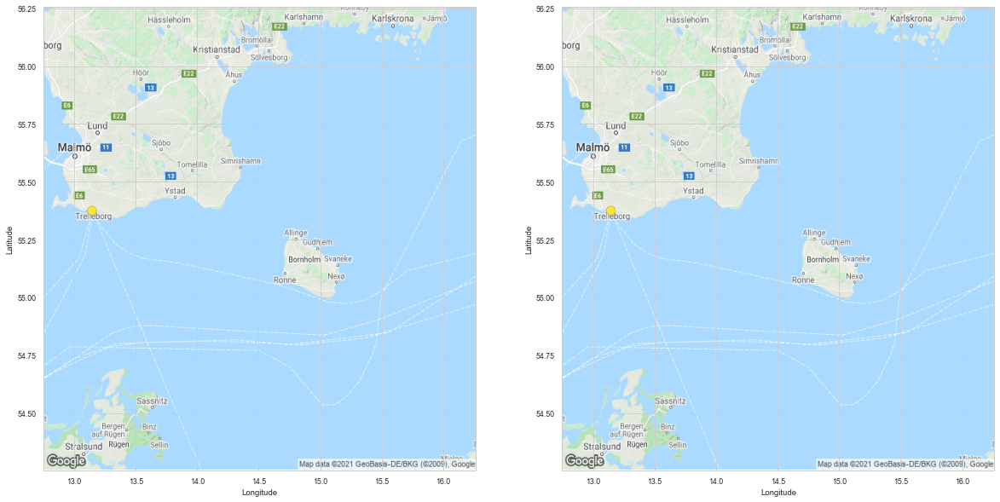

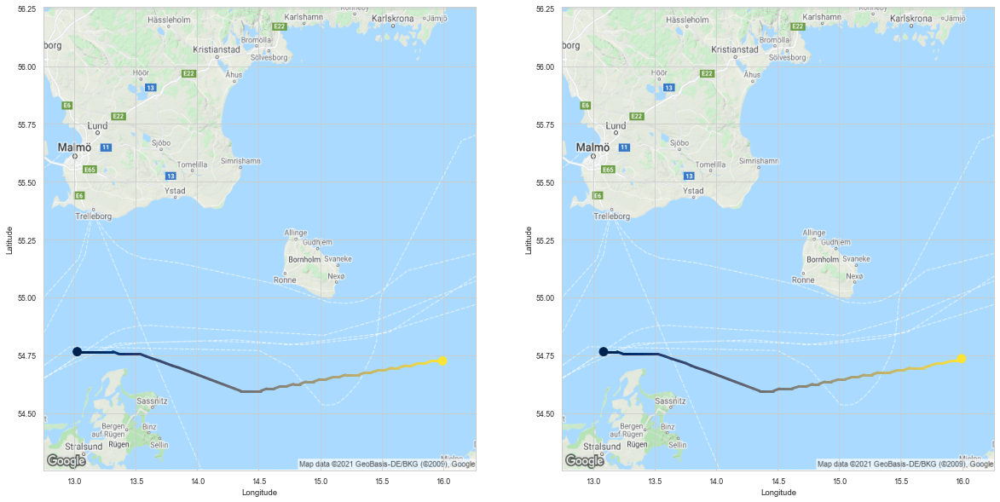

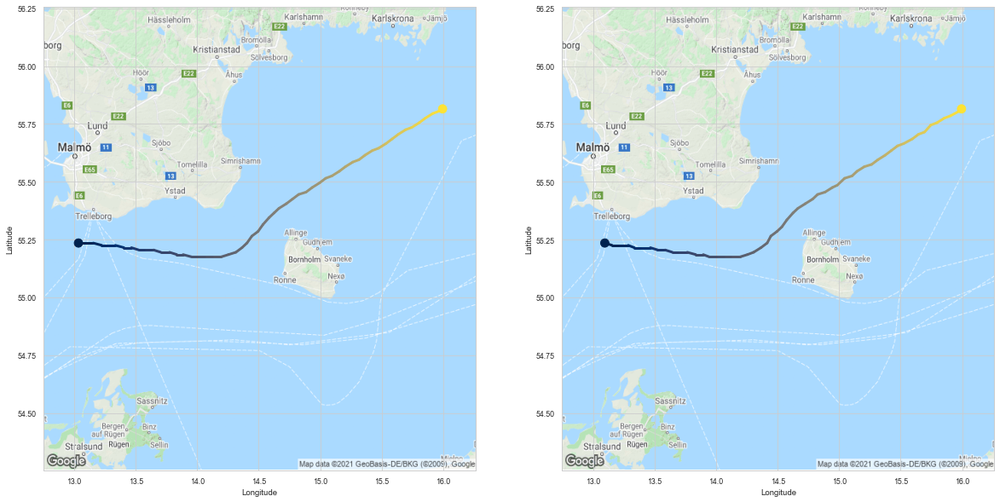

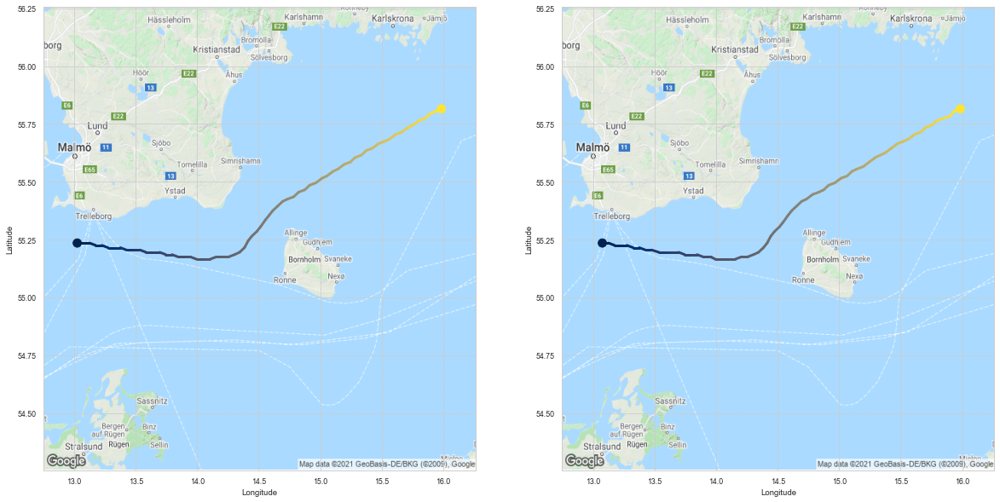

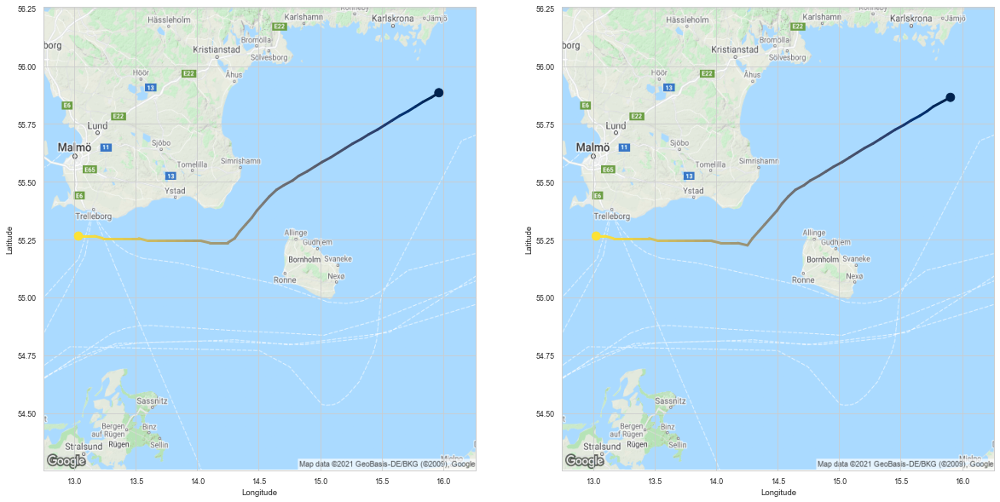

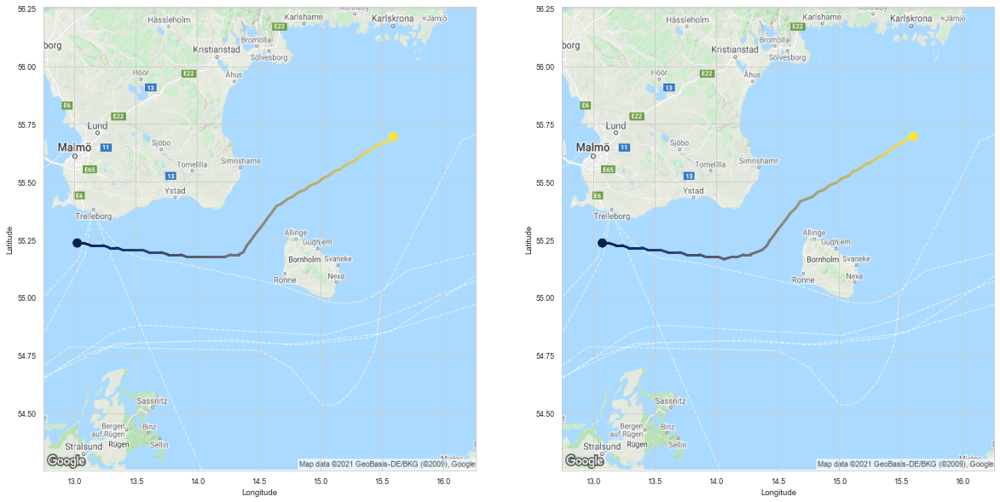

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
1634,1521,28301451,246724000,Cargo,112,-142.993530,-1.276728
357,244,54155606,371265000,Cargo,57,-204.538055,-3.588387
1554,1441,40308626,266247000,Cargo,55,-197.715546,-3.594828
1657,1544,37957629,258853000,Cargo,65,-236.780807,-3.642782
1377,1264,12166579,230350000,Cargo,47,-171.416809,-3.647166
898,785,48315538,305662000,Cargo,55,-200.925522,-3.653191


In [7]:
# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx, data_info, data_set)
df_n

# Worst Cargo Reconstructions

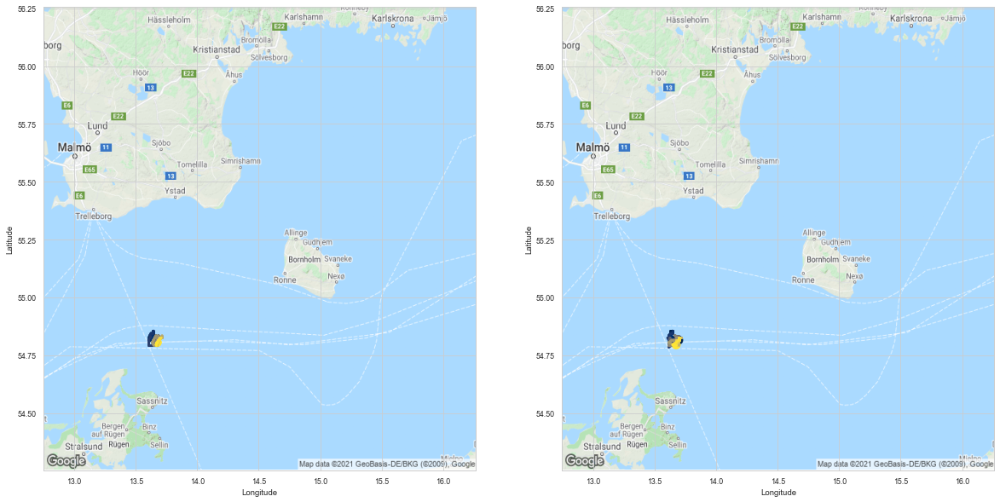

1-------------------------------------
HEAD:
   Longitude  Latitude
0     13.025    55.235
1     13.695    54.815
2     13.625    54.835
3     13.625    54.855
4     13.645    54.855
5     13.615    54.835
6     13.615    54.835
7     13.615    54.825
8     13.615    54.825
9     13.615    54.815
TAIL:
     Longitude  Latitude
123     13.675    54.795
124     13.695    54.815
125     13.705    54.815
126     13.705    54.825
127     13.695    54.825
128     13.695    54.815
129     13.695    54.815
130     13.675    54.805
131     13.645    54.795
132     13.675    54.795


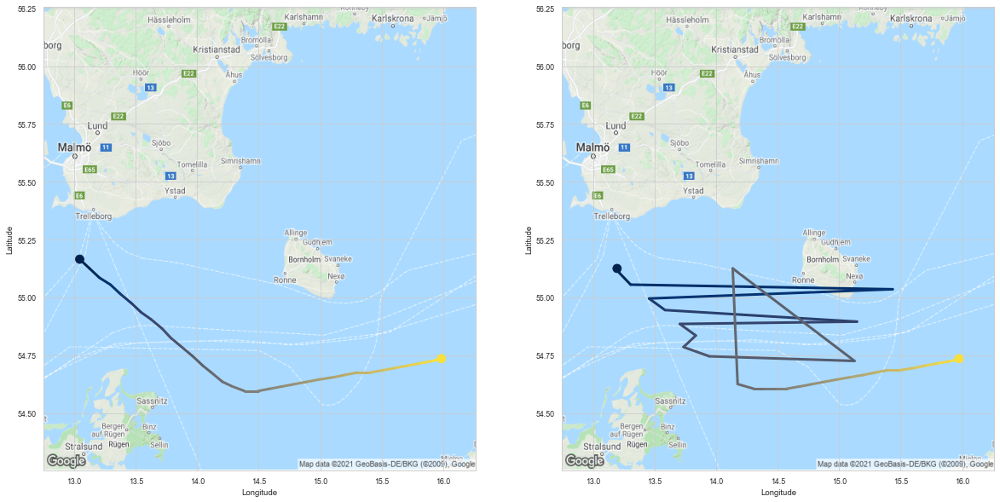

2-------------------------------------
HEAD:
   Longitude  Latitude
0     13.025    55.235
1     13.195    55.125
2     13.215    55.105
3     13.305    55.055
4     15.435    55.035
5     13.455    54.995
6     13.585    54.945
7     15.145    54.895
8     13.705    54.885
9     13.835    54.835
TAIL:
    Longitude  Latitude
23     15.095    54.655
24     15.205    54.665
25     15.295    54.675
26     15.395    54.685
27     15.495    54.685
28     15.615    54.695
29     15.705    54.705
30     15.805    54.715
31     15.915    54.725
32     15.975    54.735


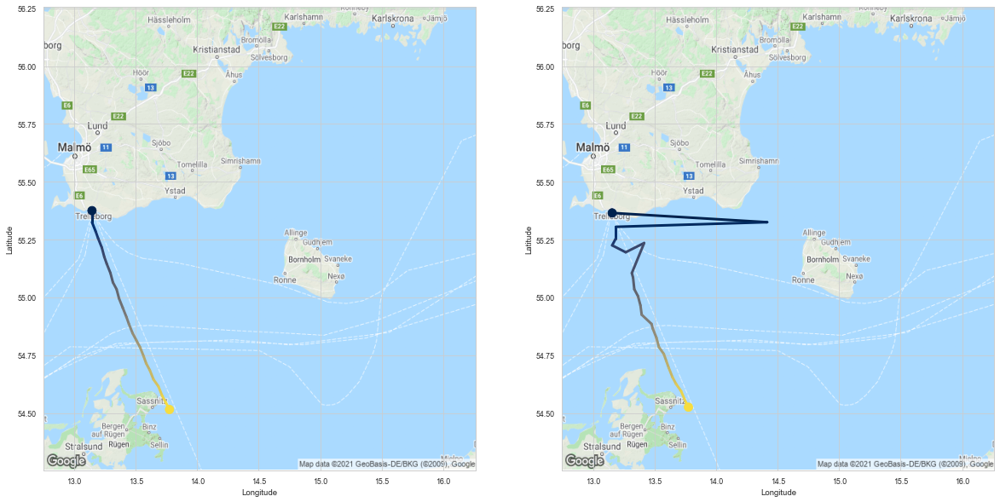

3-------------------------------------
HEAD:
   Longitude  Latitude
0     13.025    55.235
1     13.155    55.365
2     14.415    55.325
3     13.185    55.305
4     13.185    55.255
5     13.155    55.225
6     13.265    55.195
7     13.415    55.235
8     13.315    55.105
9     13.325    55.085
TAIL:
    Longitude  Latitude
16     13.515    54.825
17     13.535    54.785
18     13.575    54.755
19     13.595    54.725
20     13.615    54.695
21     13.645    54.655
22     13.675    54.625
23     13.715    54.595
24     13.755    54.545
25     13.775    54.525


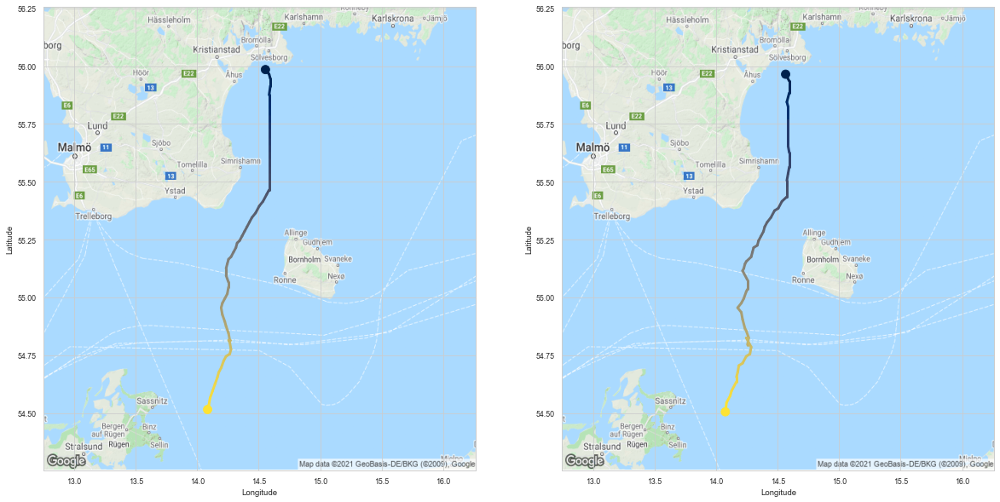

4-------------------------------------
HEAD:
   Longitude  Latitude
0     13.025    55.235
1     14.565    55.965
2     14.595    55.935
3     14.595    55.925
4     14.595    55.885
5     14.575    55.845
6     14.585    55.825
7     14.585    55.785
8     14.585    55.755
9     14.585    55.725
TAIL:
    Longitude  Latitude
52     14.245    54.745
53     14.215    54.715
54     14.185    54.705
55     14.175    54.675
56     14.165    54.655
57     14.165    54.635
58     14.125    54.595
59     14.115    54.575
60     14.085    54.545
61     14.075    54.505


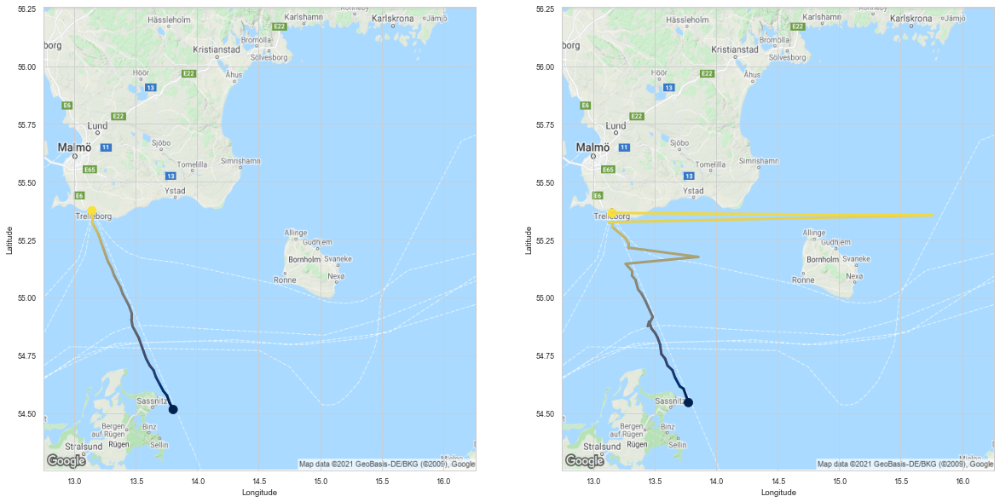

5-------------------------------------
HEAD:
   Longitude  Latitude
0     13.025    55.235
1     13.775    54.545
2     13.755    54.575
3     13.735    54.605
4     13.705    54.615
5     13.665    54.655
6     13.645    54.685
7     13.605    54.705
8     13.585    54.735
9     13.555    54.755
TAIL:
    Longitude  Latitude
25     13.285    55.215
26     13.285    55.235
27     13.265    55.255
28     13.155    55.305
29     13.155    55.305
30     13.155    55.325
31     13.125    55.325
32     15.755    55.355
33     13.155    55.365
34     13.155    55.365


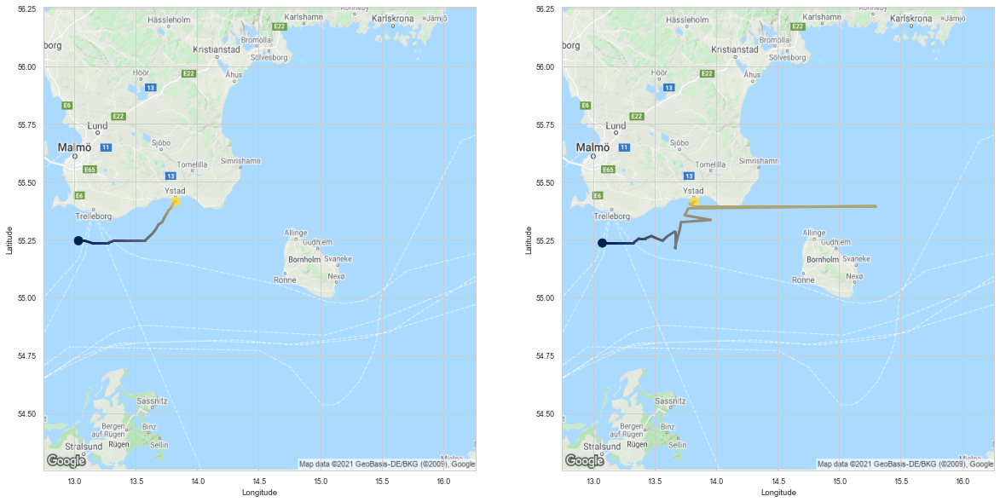

6-------------------------------------
HEAD:
   Longitude  Latitude
0     13.025    55.235
1     13.075    55.235
2     13.135    55.235
3     13.205    55.235
4     13.225    55.235
5     13.275    55.235
6     13.325    55.235
7     13.375    55.255
8     13.425    55.255
9     13.475    55.265
TAIL:
    Longitude  Latitude
19     13.775    55.385
20     15.295    55.395
21     13.815    55.395
22     13.785    55.405
23     13.805    55.395
24     13.815    55.415
25     13.825    55.415
26     13.825    55.415
27     13.825    55.415
28     13.825    55.415


,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
471,358,8666252,218862000,Cargo,133,-1771.351562,-13.318433
1374,1261,10369915,220464000,Cargo,33,-427.328064,-12.949335
1692,1579,39253403,265365000,Cargo,26,-330.198853,-12.699956
771,658,24144975,245180000,Cargo,62,-777.809692,-12.545318
1470,1357,37893265,258829000,Cargo,35,-435.200043,-12.434287
1582,1469,50617955,311000714,Cargo,29,-351.551392,-12.122462


In [8]:
# Focus on the n worst cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=True, vessel_type=vessel_type)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]
data_set = train_evaluate.validation_dataloader.dataset.datasets[data_set_i]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx, data_info, data_set)
    print(f"{idx+1}-------------------------------------")
    print("HEAD:")
    print(tracks['Reconstructed trajectory'].head(10))
    print("TAIL:")
    print(tracks['Reconstructed trajectory'].tail(10))
df_n

# Worst n=25 Cargo Reconstructions

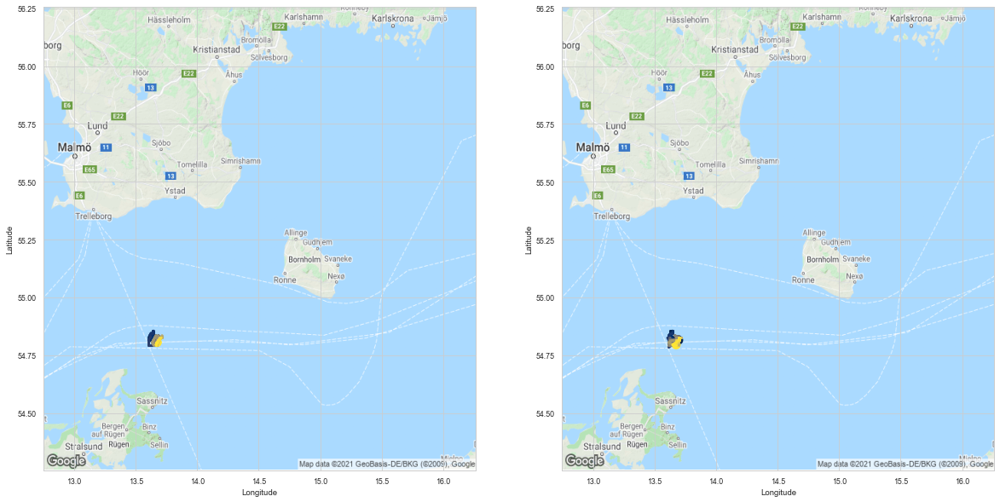

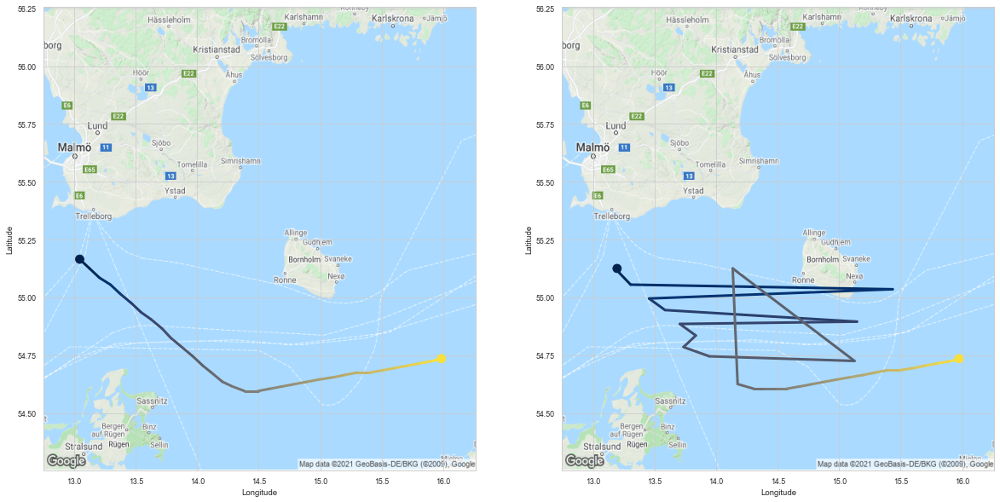

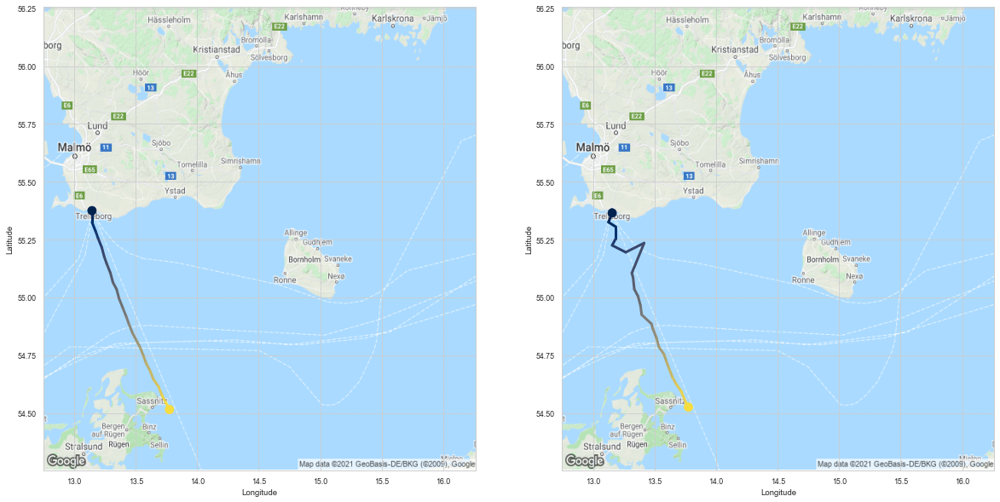

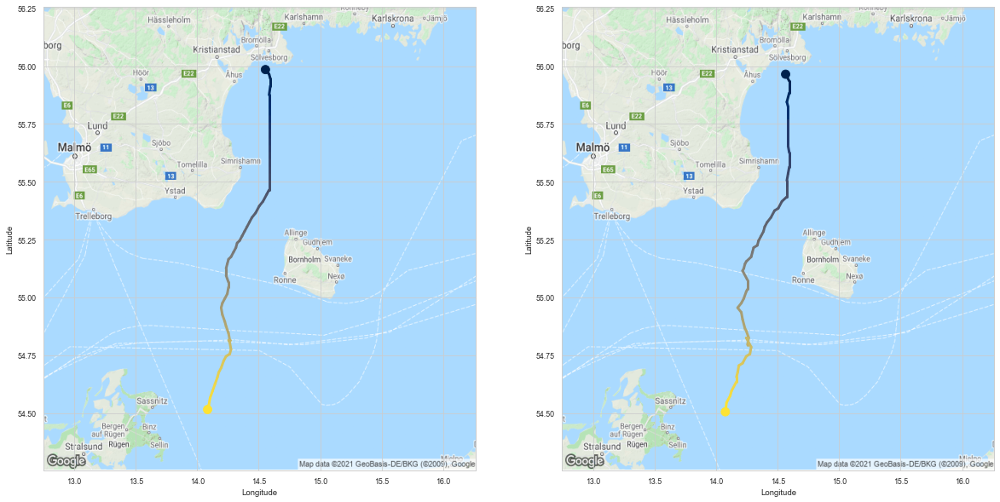

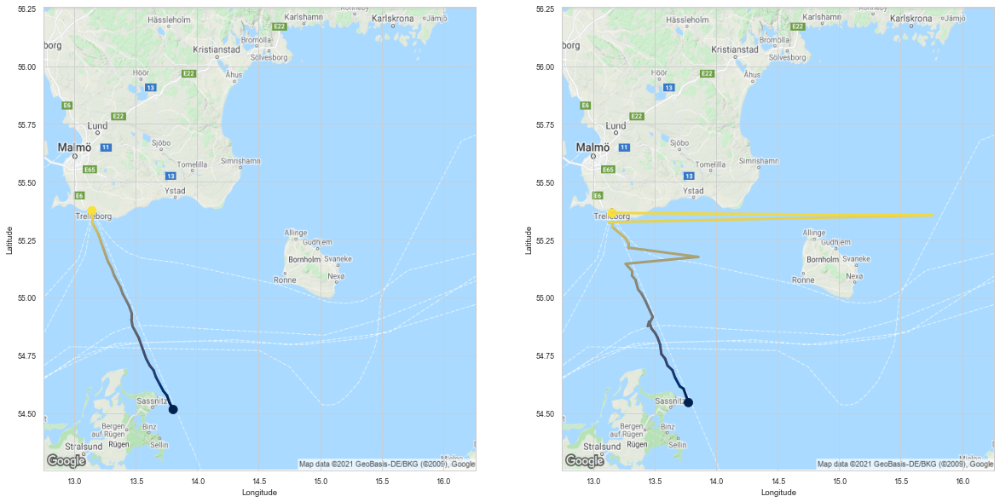

...

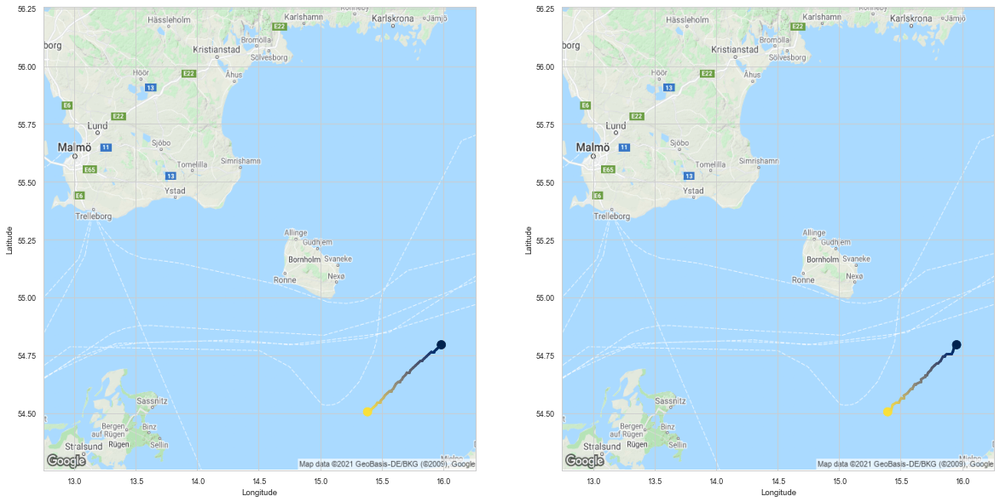

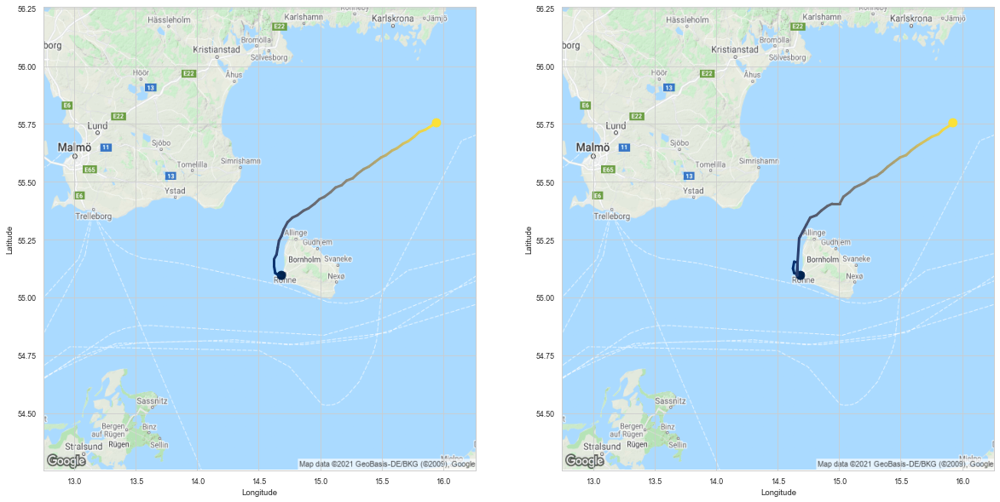

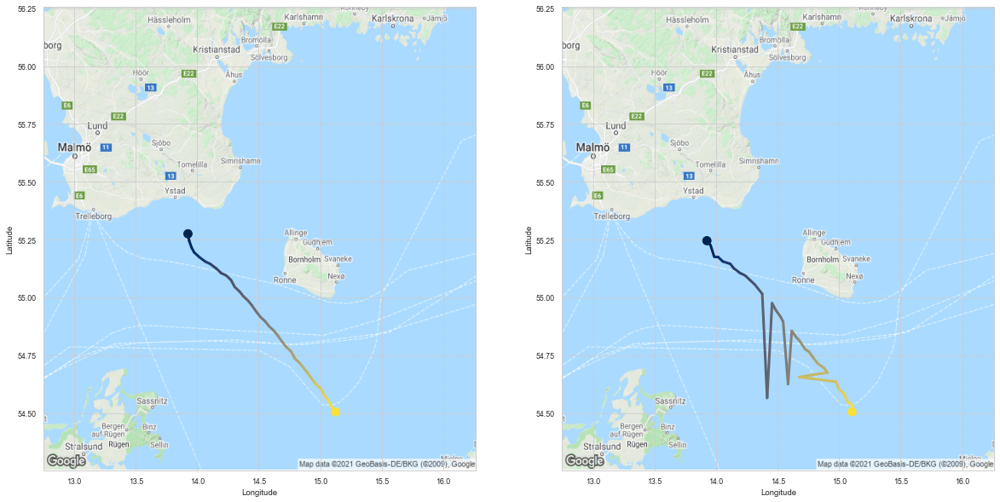

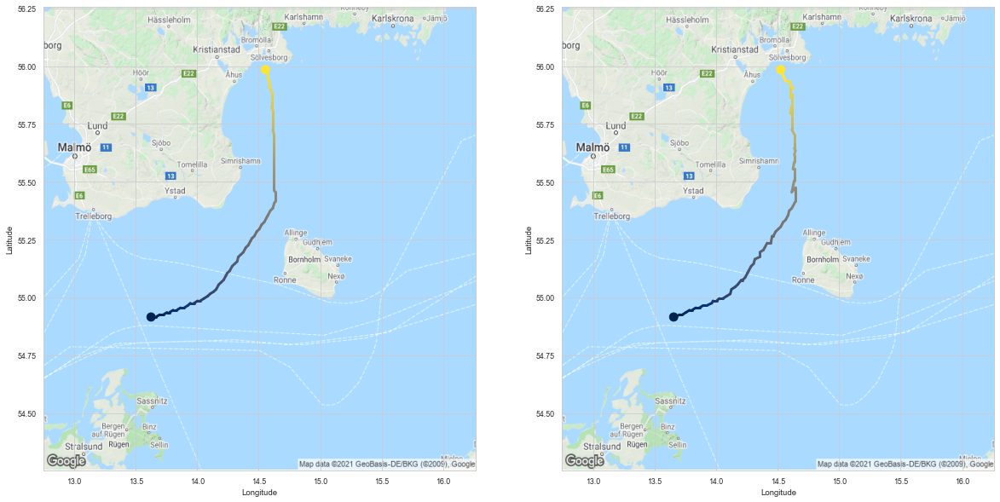

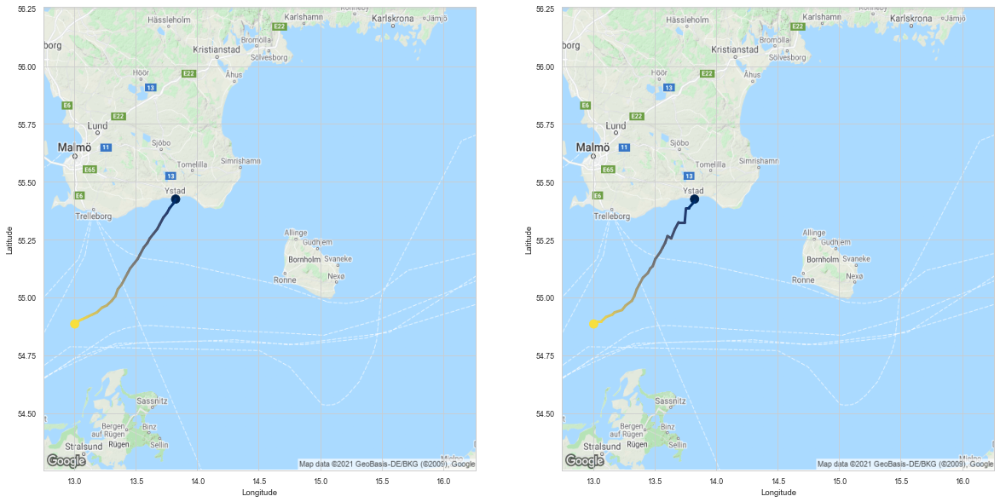

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
471,358,8666252,218862000,Cargo,133,-1771.678223,-13.320889
1374,1261,10369915,220464000,Cargo,33,-427.196594,-12.945351
1692,1579,39253403,265365000,Cargo,26,-330.291992,-12.703538
771,658,24144975,245180000,Cargo,62,-777.713989,-12.543774
1470,1357,37893265,258829000,Cargo,35,-435.518982,-12.443399
1582,1469,50617955,311000714,Cargo,29,-351.604675,-12.124299
131,18,62630736,636016233,Cargo,51,-606.260498,-11.887461
463,350,44594593,304218000,Cargo,115,-1340.436279,-11.655968
1769,1656,3569954,211234480,Cargo,27,-309.471039,-11.461890
1056,943,17741242,236205000,Cargo,53,-602.055908,-11.359545


In [9]:
# Focus on the n=25 worst cargo reconstructions
data = summary_models.run_evaluation_get_n(n=25, worst=True, vessel_type=vessel_type)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]
data_set = train_evaluate.validation_dataloader.dataset.datasets[data_set_i]

# Plot the actual and reconstructed trajectories side by side
for idx in range(25): 
    tracks = plot_actual_reconstructed(idx, data_info, data_set)
df_n

# Best Fishing Reconstructions

0


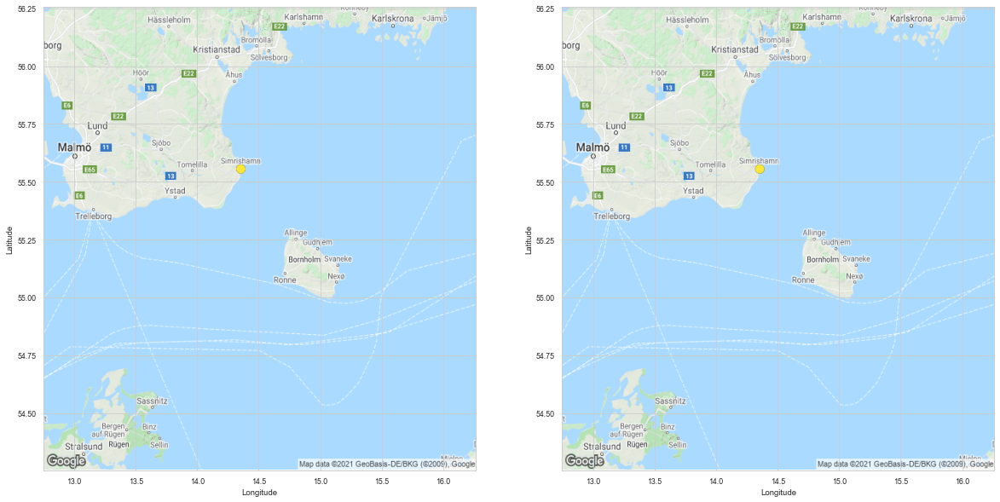

1


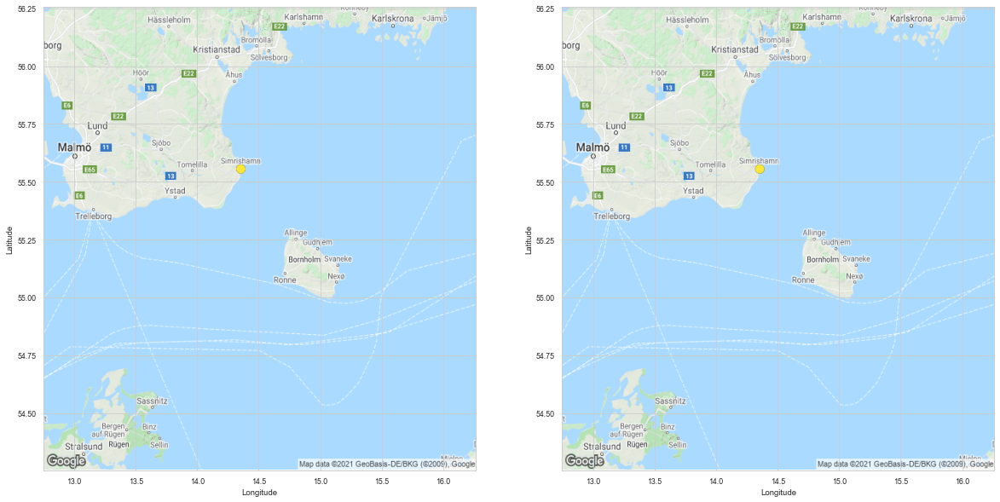

2


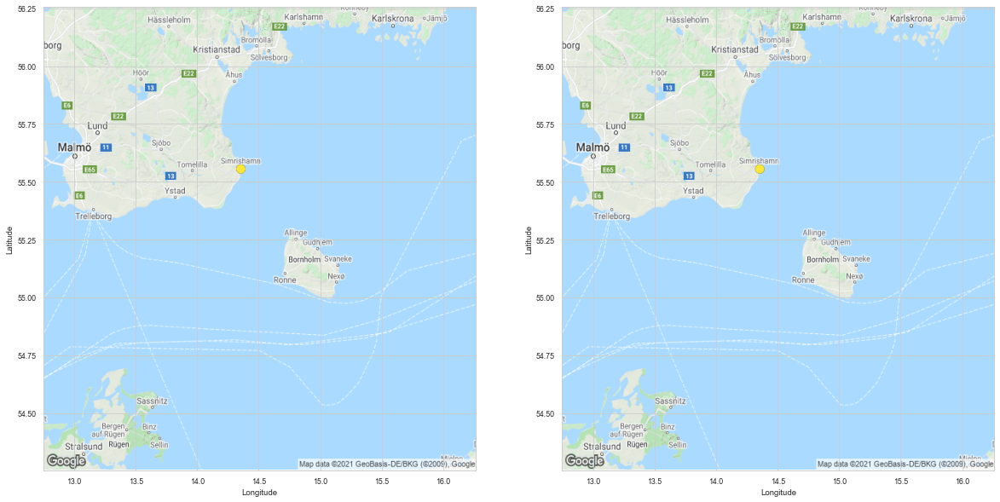

3


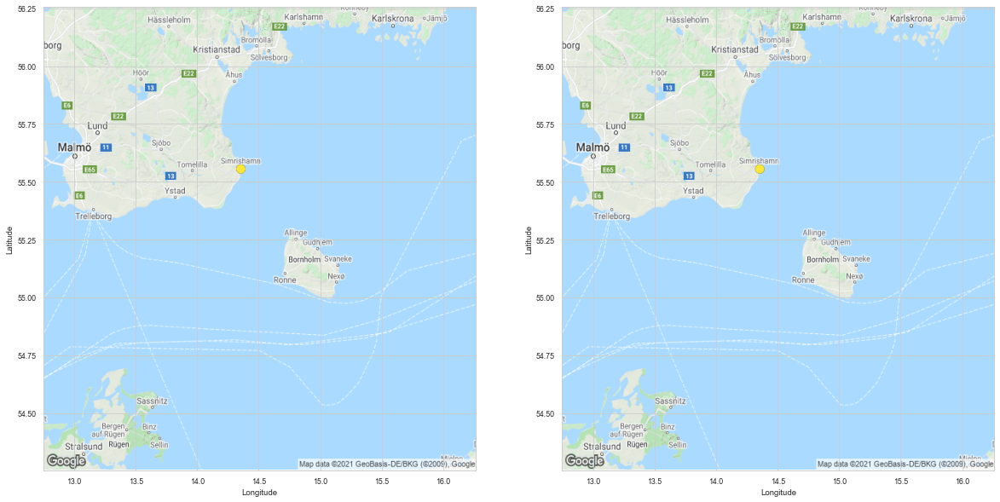

4


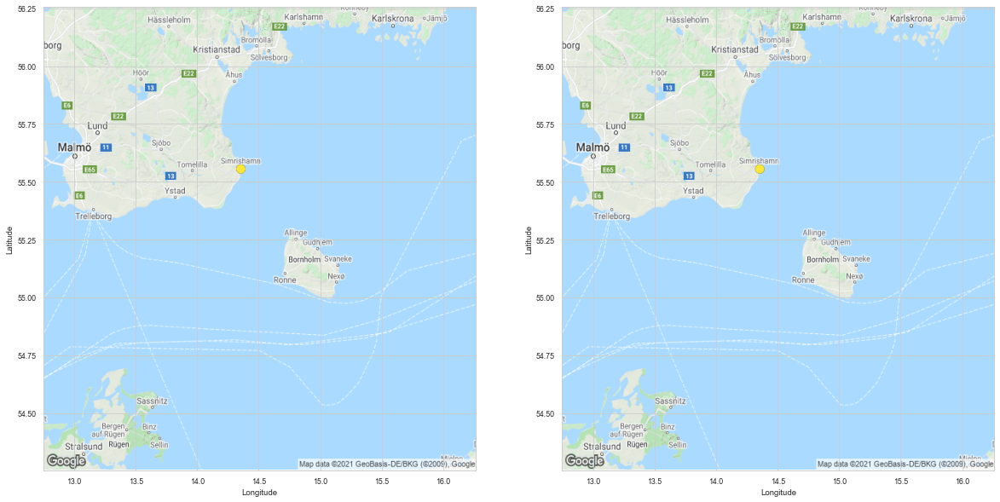

5


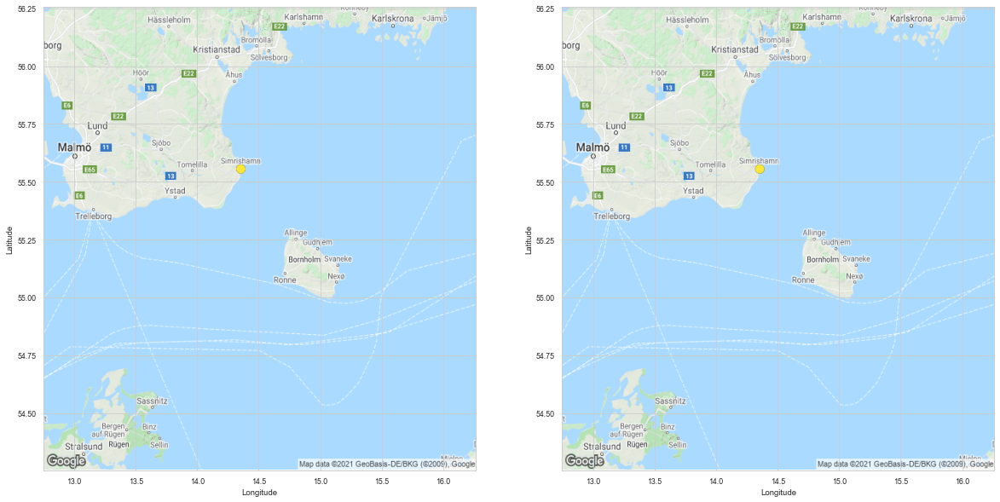

6


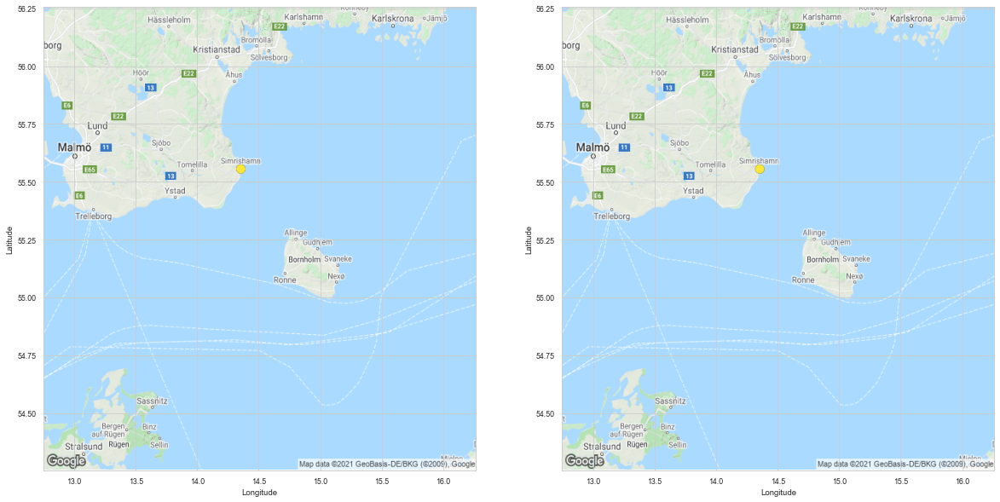

7


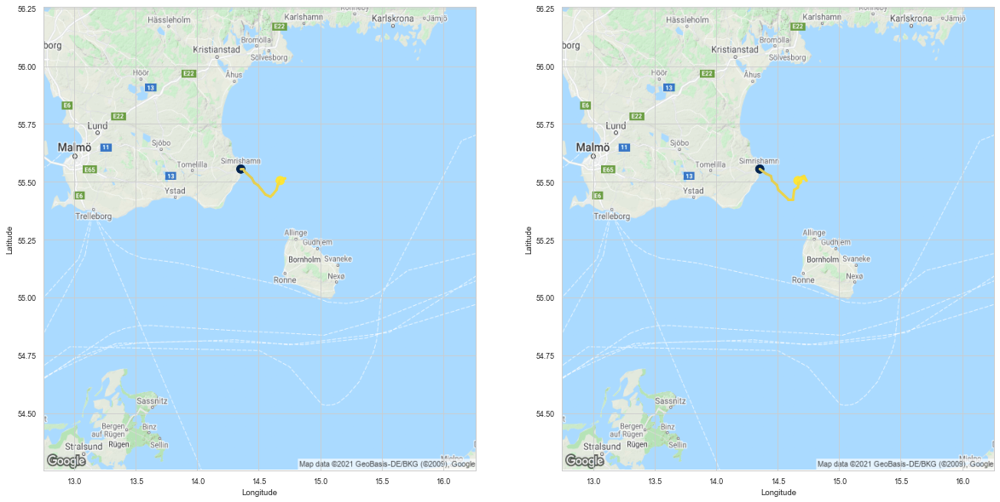

8


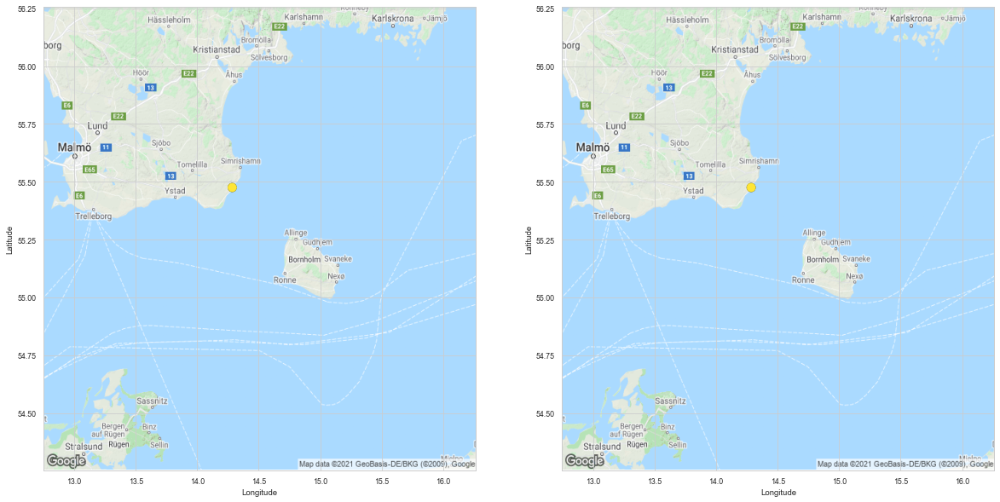

9


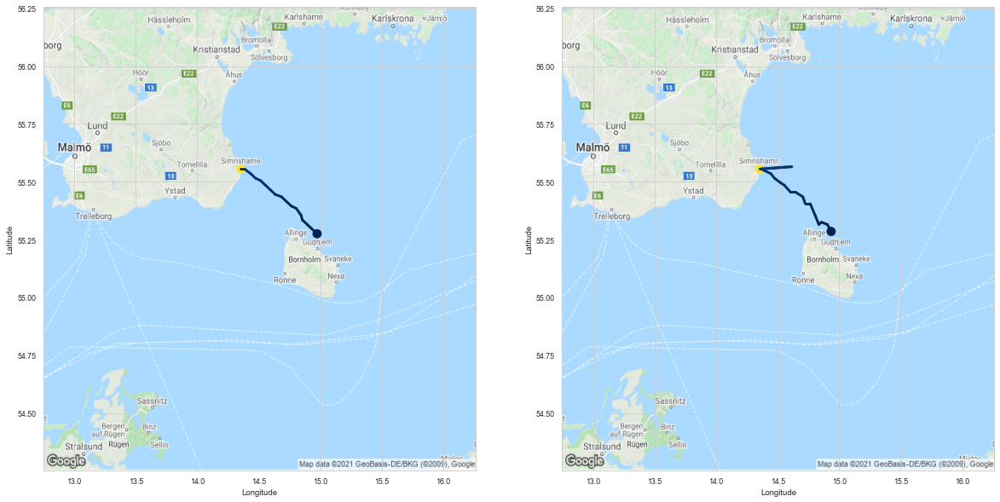

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
100,100,1583421,219021428,Fishing,135,-36.662365,-0.271573
52,52,5635000,265750000,Fishing,140,-87.649292,-0.626066
85,85,6525750,265755000,Fishing,141,-141.617340,-1.004378
43,43,5760657,265750000,Fishing,139,-145.614868,-1.047589
42,42,5972813,265754000,Fishing,143,-232.126923,-1.623265
76,76,5480216,265750000,Fishing,142,-240.238739,-1.691822
103,103,6064863,265754000,Fishing,143,-263.281738,-1.841131
11,11,6489434,265755000,Fishing,141,-373.456482,-2.648628
57,57,4868710,265551874,Fishing,116,-336.582367,-2.901572
84,84,5461932,265750000,Fishing,142,-474.548706,-3.341892


In [10]:
# Focus on the n best fishing reconstructions
vessel_type = "Fishing"
data_info = data_infos[vessel_type]
data = summary_models.run_evaluation_get_n(n=10, worst=False, vessel_type=vessel_type)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]
data_set_i = 1 if vessel_type == "Cargo" else 0
data_set = train_evaluate.validation_dataloader.dataset.datasets[data_set_i]

# Plot the actual and reconstructed trajectories side by side
for idx in range(10): 
    print(idx)
    tracks = plot_actual_reconstructed(idx, data_info, data_set)
df_n

# Worst Fishing Reconstructions

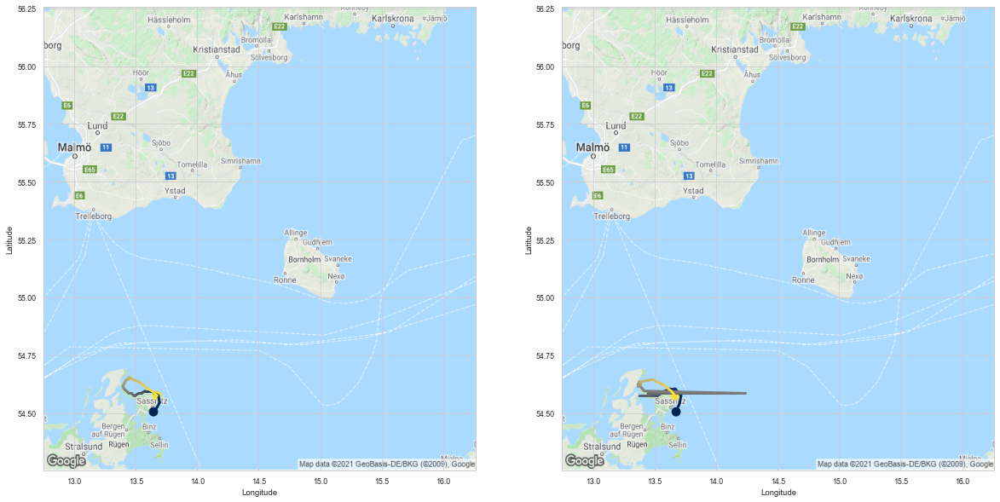

HEAD:
   Longitude  Latitude
0     13.025    55.235
1     13.675    54.505
2     13.705    54.545
3     13.715    54.575
4     13.665    54.605
5     13.625    54.605
6     13.585    54.595
7     13.575    54.585
8     13.585    54.595
9     13.525    54.575
TAIL:
    Longitude  Latitude
20     13.375    54.635
21     13.385    54.625
22     13.385    54.635
23     13.385    54.635
24     13.485    54.645
25     13.515    54.635
26     13.565    54.625
27     13.585    54.615
28     13.635    54.595
29     13.665    54.575


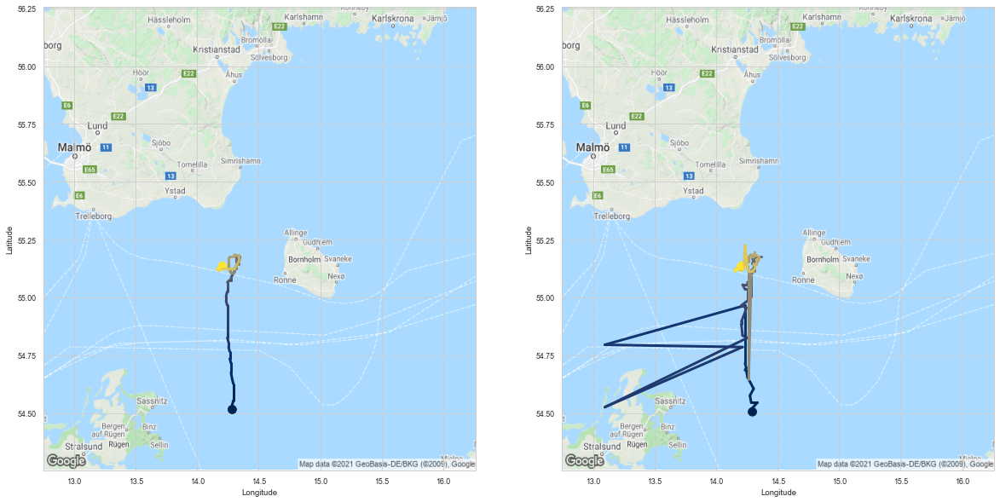

HEAD:
   Longitude  Latitude
0     13.025    55.235
1     14.295    54.505
2     14.285    54.515
3     14.335    54.545
4     14.285    54.545
5     14.275    54.575
6     14.305    54.605
7     14.255    54.655
8     14.245    54.685
9     14.235    54.685
TAIL:
     Longitude  Latitude
91      14.155    55.125
92      14.155    55.115
93      14.155    55.115
94      14.155    55.115
95      14.155    55.125
96      14.155    55.125
97      14.155    55.115
98      14.185    55.125
99      14.205    55.125
100     14.205    55.135


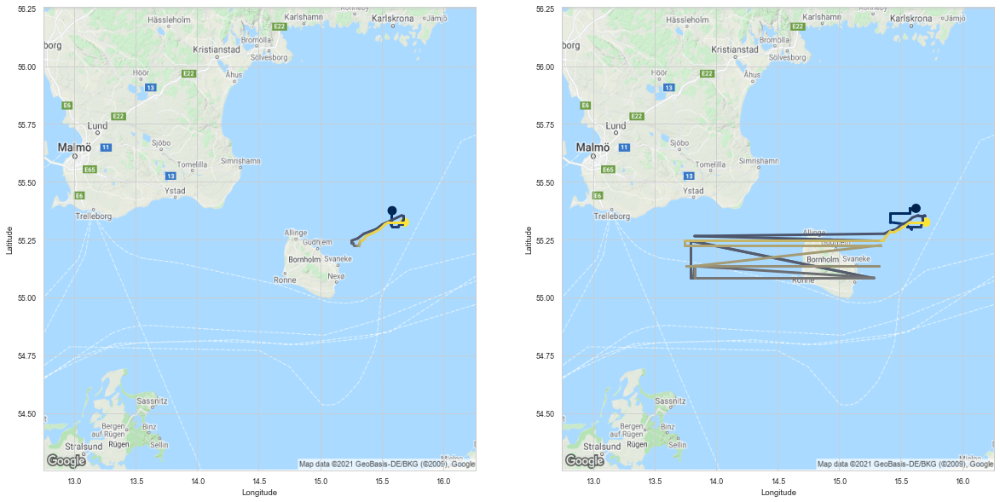

HEAD:
   Longitude  Latitude
0     13.025    55.235
1     15.625    55.385
2     15.605    55.375
3     15.575    55.385
4     15.575    55.375
5     15.575    55.365
6     15.415    55.365
7     15.415    55.345
8     15.415    55.345
9     15.415    55.325
TAIL:
    Longitude  Latitude
90     15.415    55.285
91     15.455    55.285
92     15.495    55.295
93     15.525    55.305
94     15.575    55.325
95     15.575    55.325
96     15.625    55.325
97     15.665    55.325
98     15.675    55.325
99     15.705    55.325


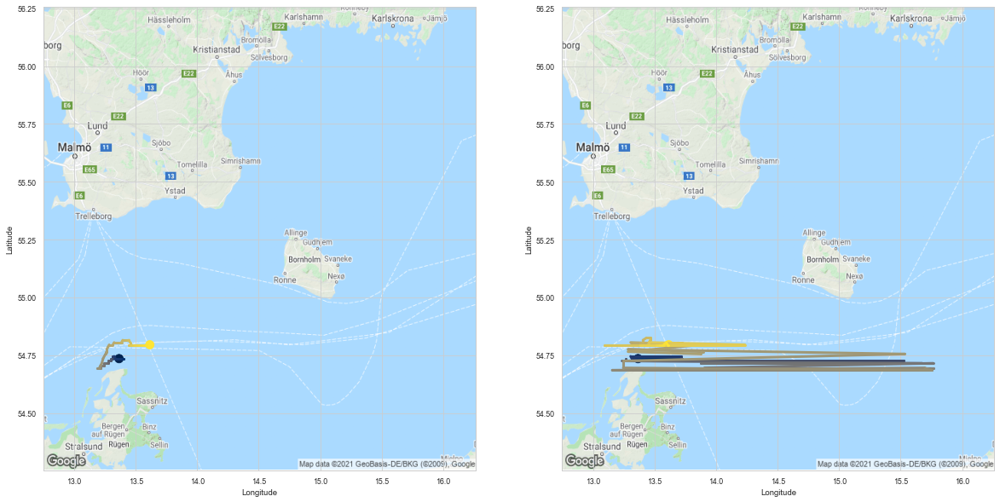

HEAD:
   Longitude  Latitude
0     13.025    55.235
1     13.365    54.735
2     13.365    54.735
3     13.345    54.735
4     13.345    54.735
5     13.345    54.735
6     13.345    54.725
7     13.345    54.735
8     13.725    54.735
9     13.325    54.735
TAIL:
     Longitude  Latitude
100     13.505    54.795
101     13.515    54.795
102     13.525    54.795
103     13.535    54.795
104     13.545    54.795
105     13.555    54.795
106     13.575    54.795
107     13.595    54.805
108     13.605    54.795
109     13.615    54.795


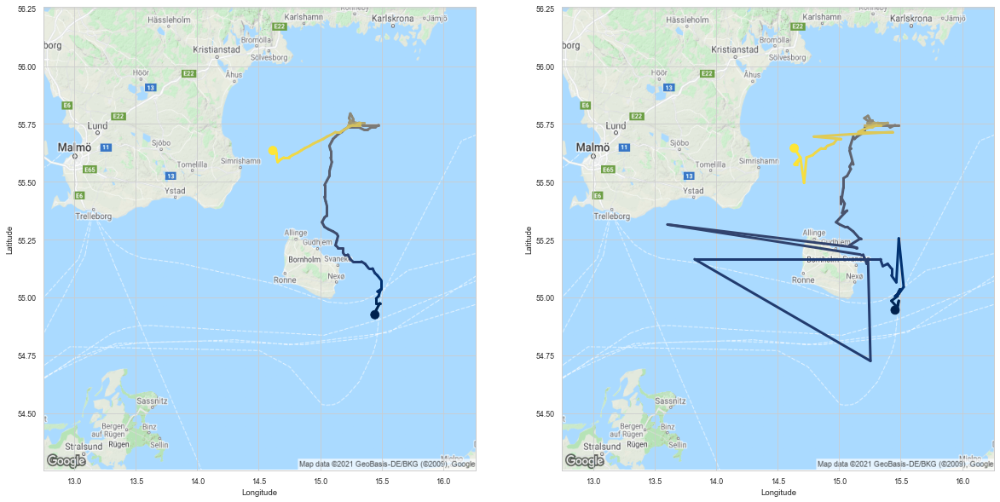

HEAD:
   Longitude  Latitude
0     13.025    55.235
1     15.455    54.945
2     15.475    54.965
3     15.485    54.985
4     15.475    54.955
5     15.425    54.985
6     15.475    55.005
7     15.485    55.025
8     15.495    55.035
9     15.475    55.015
TAIL:
     Longitude  Latitude
125     14.855    55.645
126     14.805    55.625
127     14.785    55.615
128     14.735    55.605
129     14.715    55.495
130     14.685    55.605
131     14.655    55.575
132     14.635    55.575
133     14.685    55.605
134     14.635    55.645


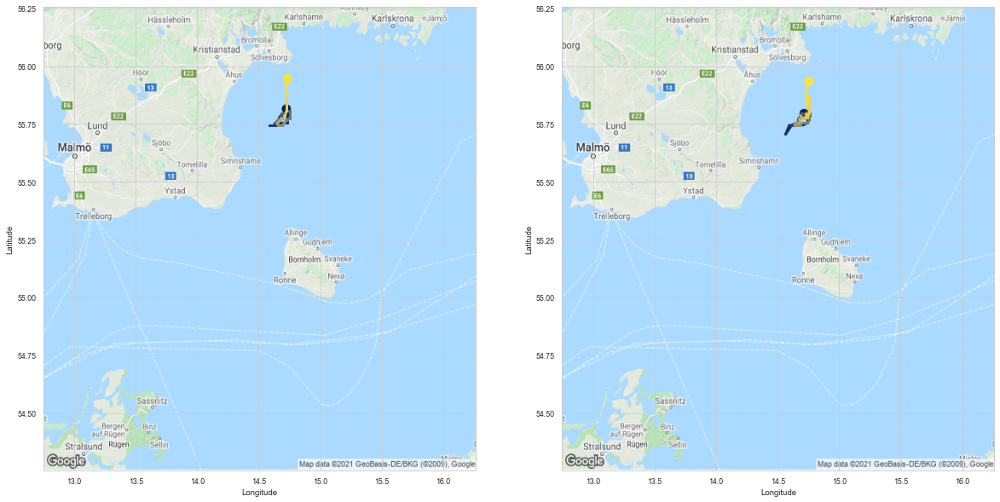

HEAD:
   Longitude  Latitude
0     13.025    55.235
1     14.715    55.795
2     14.745    55.775
3     14.745    55.755
4     14.705    55.745
5     14.665    55.755
6     14.615    55.745
7     14.565    55.705
8     14.595    55.745
9     14.605    55.745
TAIL:
    Longitude  Latitude
48     14.725    55.775
49     14.735    55.795
50     14.735    55.785
51     14.745    55.775
52     14.755    55.795
53     14.755    55.815
54     14.755    55.865
55     14.735    55.835
56     14.735    55.935
57     14.755    55.935


,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
73,73,1113112,211542610,Fishing,30,-492.859833,-16.428661
48,48,4303656,261007170,Fishing,101,-1556.515991,-15.411049
5,5,6496,211215500,Fishing,100,-1434.735107,-14.347351
21,21,19488,211243240,Fishing,110,-1563.742065,-14.215837
49,49,1557318,219021428,Fishing,135,-1870.657349,-13.856721
38,38,4942336,265593190,Fishing,58,-734.109375,-12.657058


In [11]:
# Focus on the n worst fishing reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=True, vessel_type=vessel_type)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]
data_set = train_evaluate.validation_dataloader.dataset.datasets[data_set_i]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx, data_info, data_set)
    print("HEAD:")
    print(tracks['Reconstructed trajectory'].head(10))
    print("TAIL:")
    print(tracks['Reconstructed trajectory'].tail(10))
df_n

# Worst n=25 fishing Reconstructions

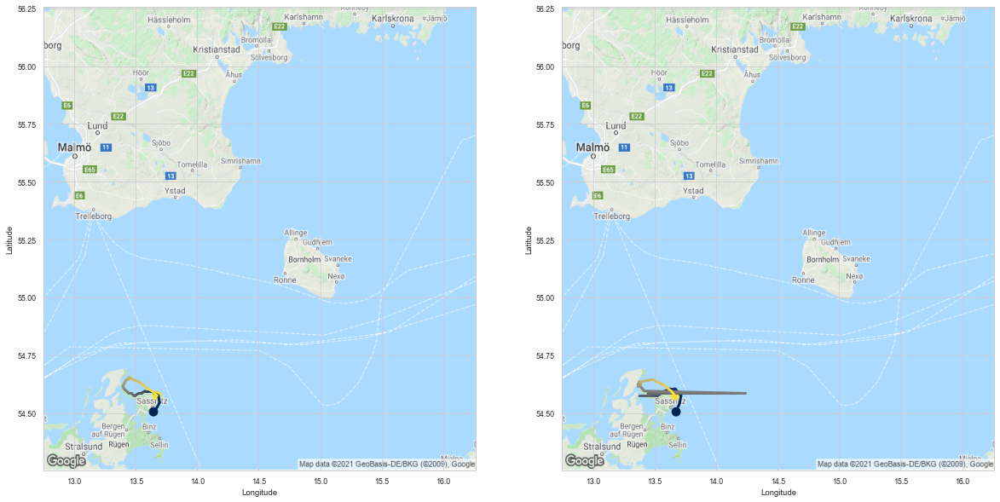

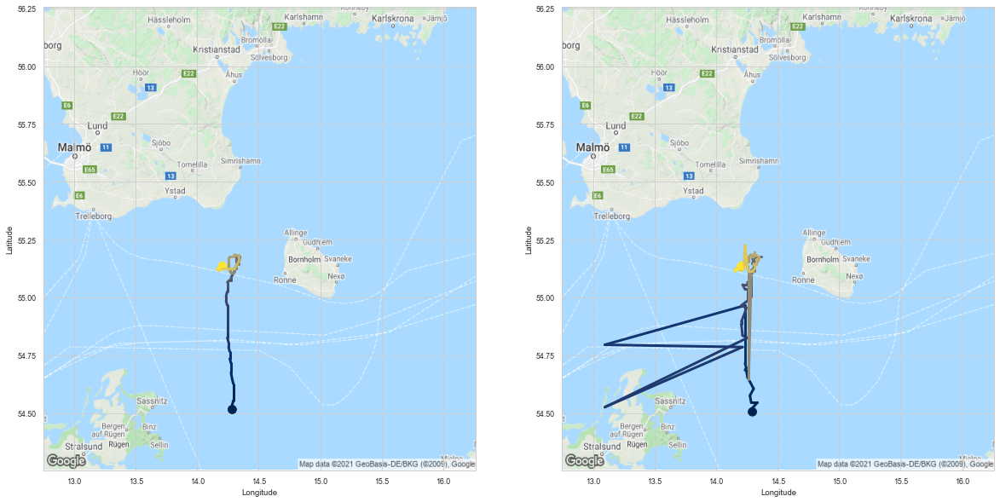

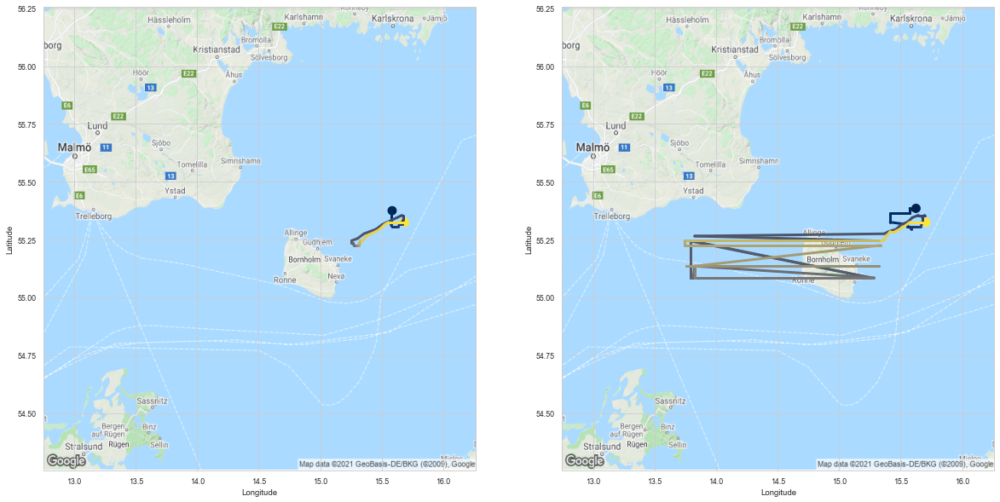

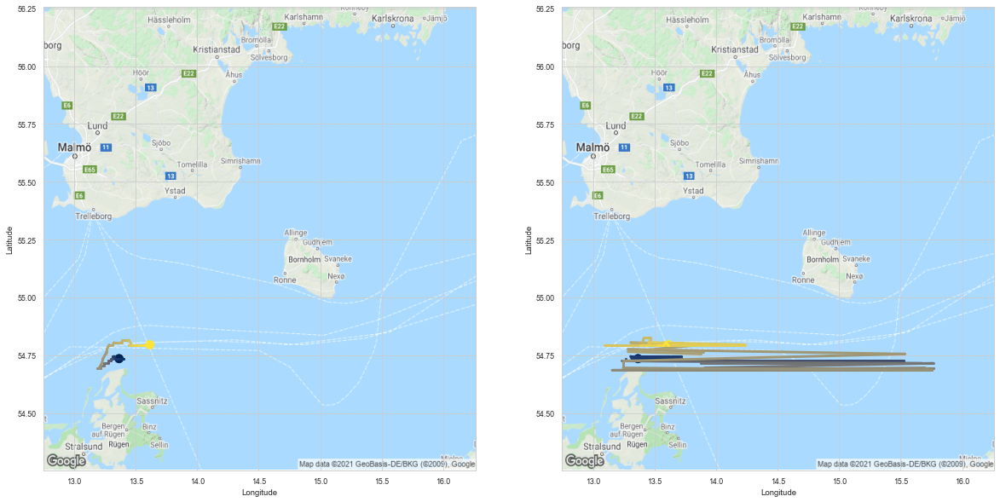

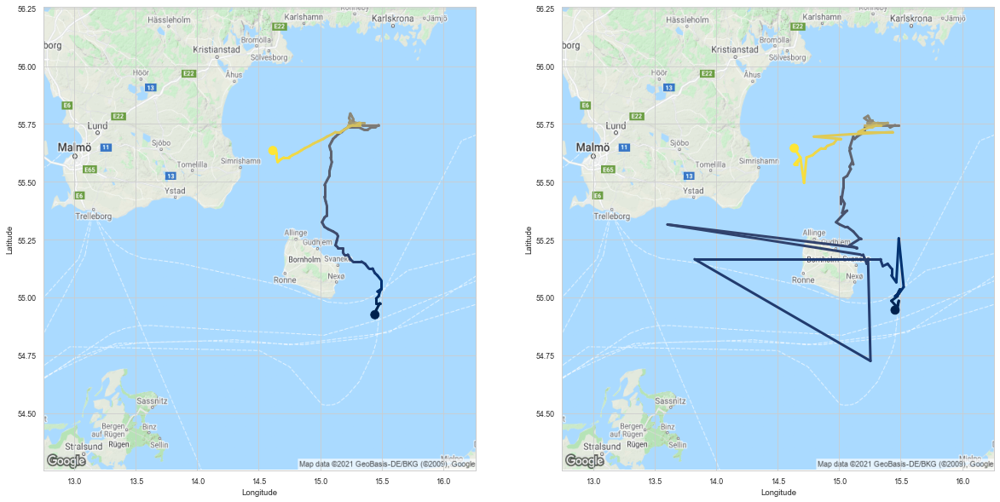

...

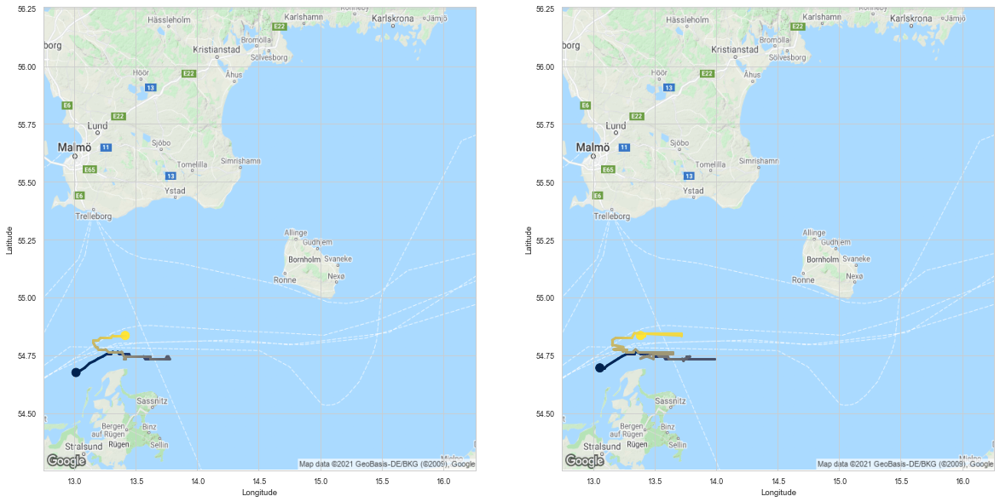

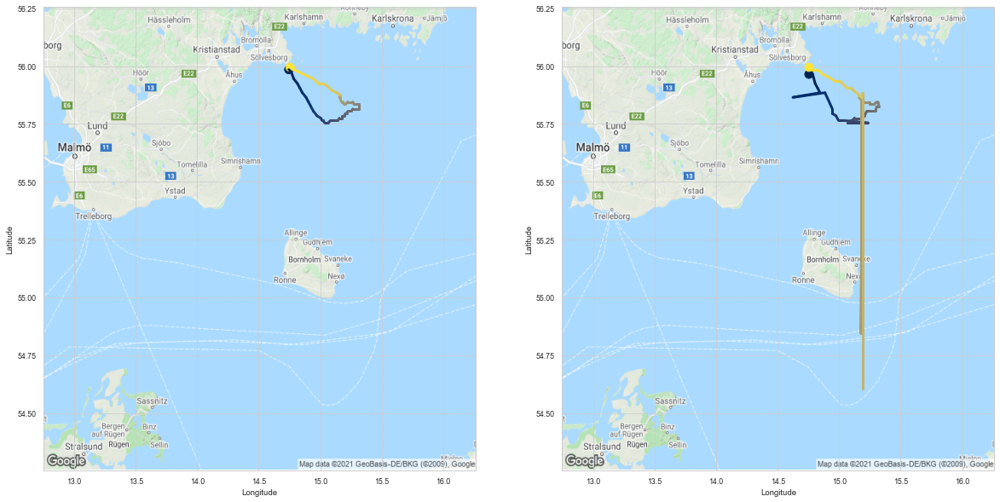

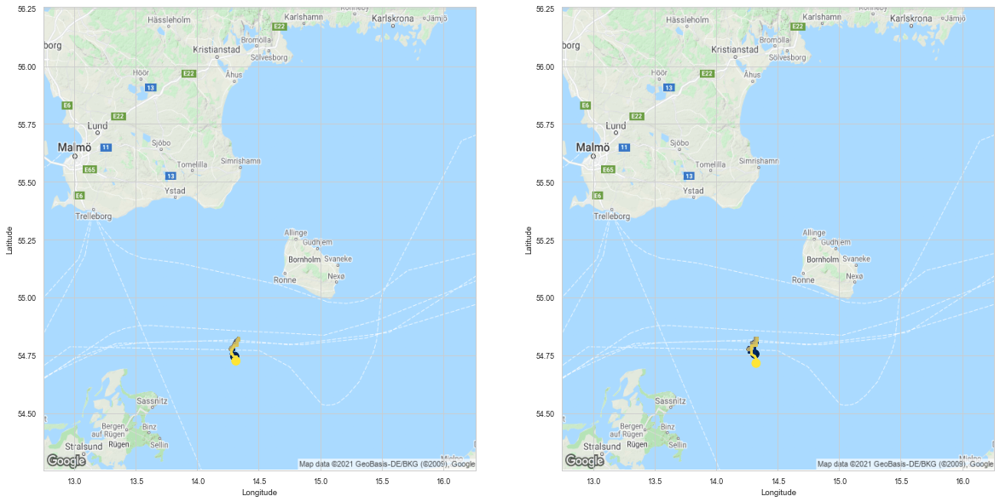

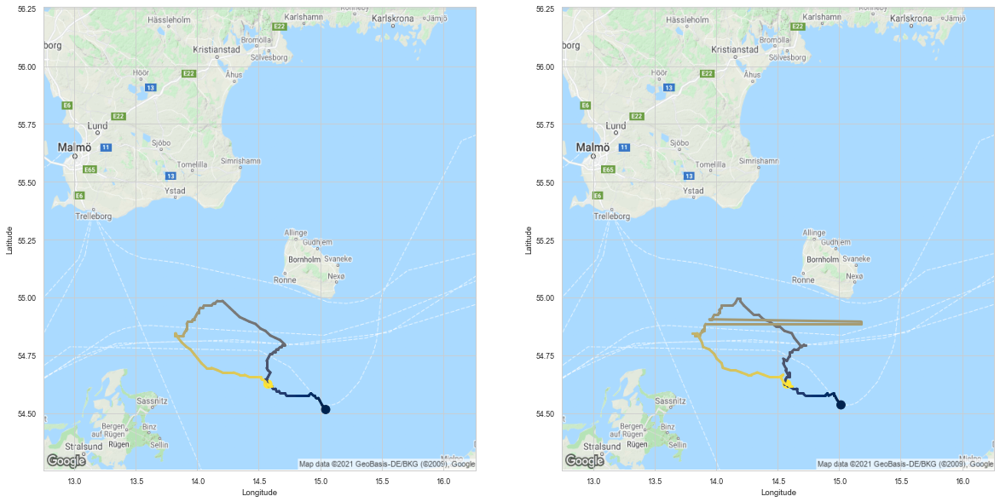

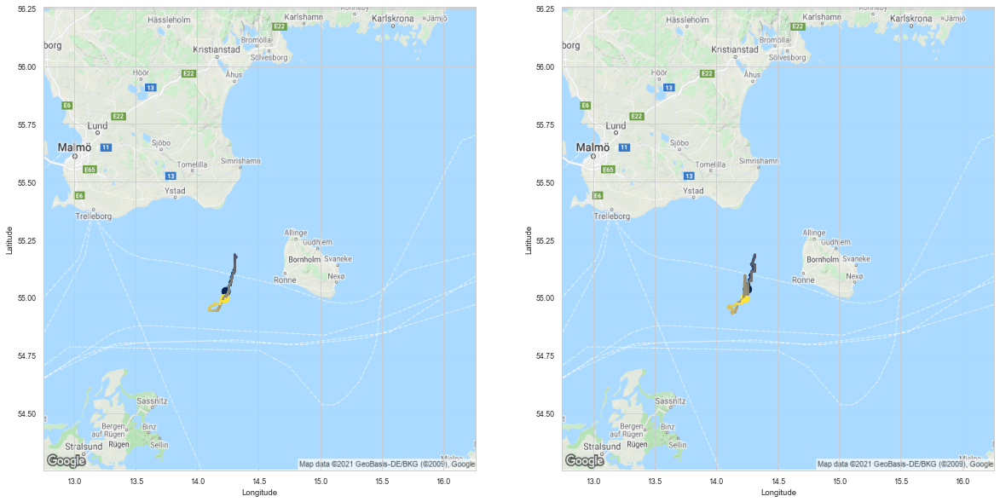

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
73,73,1113112,211542610,Fishing,30,-493.131226,-16.437708
48,48,4303656,261007170,Fishing,101,-1556.024658,-15.406185
5,5,6496,211215500,Fishing,100,-1434.594604,-14.345946
21,21,19488,211243240,Fishing,110,-1563.363525,-14.212396
49,49,1557318,219021428,Fishing,135,-1870.376221,-13.854639
38,38,4942336,265593190,Fishing,58,-734.306824,-12.660462
63,63,7579789,266315000,Fishing,60,-743.751343,-12.395856
91,91,5598936,265750000,Fishing,140,-1732.628296,-12.375916
1,1,4547326,261061000,Fishing,31,-376.807861,-12.155092
7,7,3067071,261002520,Fishing,83,-987.282898,-11.894975


In [12]:
# Focus on the n=25 worst fishing reconstructions
data = summary_models.run_evaluation_get_n(n=25, worst=True, vessel_type=vessel_type)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]
data_set = train_evaluate.validation_dataloader.dataset.datasets[data_set_i]

# Plot the actual and reconstructed trajectories side by side
for idx in range(25): 
    tracks = plot_actual_reconstructed(idx, data_info, data_set)
df_n